In [4]:
import pandas as pd
from gensim.models import LdaModel
from gensim.corpora import Dictionary
from gensim.utils import simple_preprocess
from nltk.corpus import stopwords
import string

# Load the CSV file
df = pd.read_csv("sectionized_data.csv")
df = df.dropna()

# Preprocessing function
def preprocess(text):
    stop_words = set(stopwords.words('english'))
    text = text.lower()  # Convert text to lowercase
    text = text.translate(str.maketrans('', '', string.punctuation))  # Remove punctuation
    tokens = simple_preprocess(text, deacc=True)  # Tokenize and remove accents
    tokens = [token for token in tokens if token not in stop_words]  # Remove stopwords
    return tokens

# Tokenize and preprocess the text
df['Body'] = df['Body'].astype(str)
df['tokens'] = df['Body'].apply(preprocess)

# Create a dictionary representation of the documents
dictionary = Dictionary(df['tokens'])

# Bag-of-words representation of the documents
corpus = [dictionary.doc2bow(doc) for doc in df['tokens']]


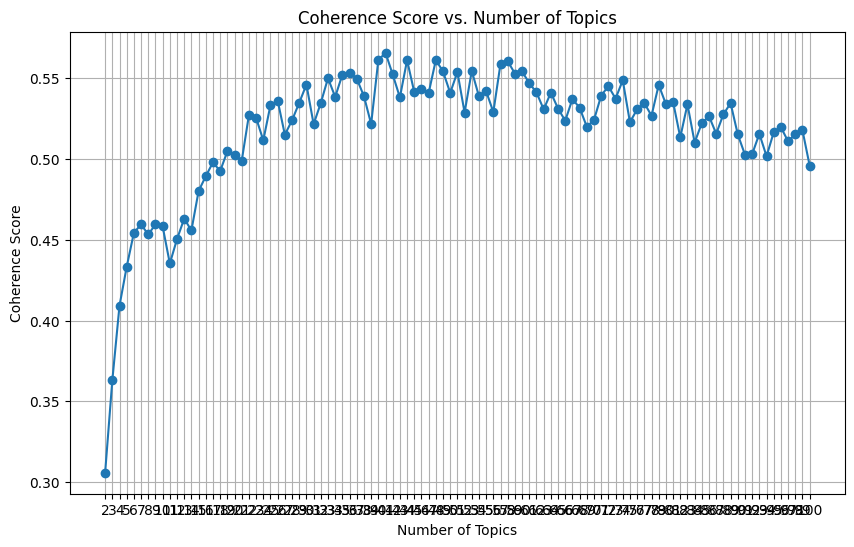

In [2]:
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt

#Optimal K
# Define a range of candidate numbers of topics
min_topics = 2
max_topics = 100
step_size = 1
topics_range = range(min_topics, max_topics + 1, step_size)

# Initialize empty lists to store coherence scores
coherence_scores = []

# Iterate through diffeent numbers of topics
for num_topics in topics_range:
    # Train LDA model
    lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=num_topics)
    
    # Calculate coherence score
    coherence_model = CoherenceModel(model=lda_model, texts=df['tokens'], dictionary=dictionary, coherence='c_v')
    coherence_score = coherence_model.get_coherence()
    
    # Append coherence score to the list
    coherence_scores.append(coherence_score)

# Plot the coherence scores
plt.figure(figsize=(10, 6))
plt.plot(topics_range, coherence_scores, marker='o', linestyle='-')
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score")
plt.title("Coherence Score vs. Number of Topics")
plt.xticks(topics_range)
plt.grid(True)
plt.show()


In [ ]:
max_coherence_score, optimal_num_topics = max(zip(coherence_scores, topics_range))

print(f"The optimal number of topics is {optimal_num_topics} with a coherence score of {max_coherence_score:.4f}.")


In [6]:
# Train LDA model
num_topics = 41 # Change this number to set the number of topics
lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=num_topics)

# Print the topics
topics_dict = {}
Topics_Str = ''
for idx, topic in lda_model.print_topics():
    Topics_Str += "Topic {}: {}".format(idx, topic) +'\n'
    #print("Topic {}: {}".format(idx, topic)) 
print(Topics_Str)

#Use LLM model to label the topics manually (if the topics are not coherent then remove those topics)
#Label the topics during the training itself and save these topics in excel
#and when testing during demo display the dominant topic label

# Save the trained model
lda_model.save("lda_model")
dictionary.save("corpus")

Topic 34: 0.056*"court" + 0.043*"high" + 0.036*"names" + 0.035*"case" + 0.034*"decision" + 0.026*"tay" + 0.025*"ang" + 0.025*"appeal" + 0.024*"date" + 0.024*"goh"
Topic 21: 0.037*"mark" + 0.034*"trade" + 0.031*"goods" + 0.018*"use" + 0.015*"marks" + 0.014*"damage" + 0.013*"liability" + 0.012*"registered" + 0.011*"negligence" + 0.011*"policy"
Topic 9: 0.117*"arbitration" + 0.086*"mdm" + 0.078*"award" + 0.045*"arbitrator" + 0.033*"tribunal" + 0.026*"rules" + 0.021*"model" + 0.020*"indonesian" + 0.019*"arbitral" + 0.019*"international"
Topic 5: 0.068*"time" + 0.055*"date" + 0.046*"period" + 0.027*"days" + 0.025*"delay" + 0.022*"months" + 0.020*"day" + 0.016*"work" + 0.015*"completion" + 0.013*"within"
Topic 24: 0.019*"works" + 0.015*"work" + 0.015*"vessel" + 0.013*"project" + 0.012*"copyright" + 0.010*"system" + 0.009*"site" + 0.009*"cargo" + 0.009*"building" + 0.007*"equipment"
Topic 4: 0.062*"letter" + 0.028*"dated" + 0.018*"sent" + 0.015*"august" + 0.013*"september" + 0.013*"october" +

In [10]:
#Testing the loaded model 

from gensim.models import LdaModel
from gensim.corpora import Dictionary

# Load the saved LDA model
lda_model = LdaModel.load("lda_model")

# Load the saved dictionary
dictionary = Dictionary.load("corpus")

# Assuming you have preprocessed text documents stored in a variable called "new_documents"
# Tokenize and preprocess the new documents
new_corpus = [dictionary.doc2bow(preprocess(doc)) for doc in df['Body']]

# Perform inference using the loaded model
for doc in new_corpus:
    topics = lda_model[doc]  # Get the topic distribution for each document
    print(topics)

[(3, 0.099529184), (14, 0.10162467), (23, 0.10241997), (32, 0.3518447), (38, 0.25664583)]
[(28, 0.8373966)]
[(34, 0.9303098)]
[(7, 0.074256904), (11, 0.08110919), (14, 0.028311413), (17, 0.058049176), (23, 0.06596617), (28, 0.38083613), (32, 0.21611865), (38, 0.05260554), (40, 0.0287772)]
[(11, 0.14291647), (17, 0.03672036), (19, 0.123415), (21, 0.010429669), (23, 0.013066132), (24, 0.0534914), (28, 0.4057619), (29, 0.020145027), (32, 0.17136496)]
[(0, 0.021920132), (11, 0.022514578), (13, 0.082259975), (23, 0.020449558), (28, 0.6298572), (29, 0.010242898), (30, 0.012721359), (31, 0.03221375), (32, 0.020885594), (33, 0.102494866), (35, 0.040968053)]
[(0, 0.023853783), (14, 0.05684428), (25, 0.027768923), (28, 0.6256478), (31, 0.038833726), (32, 0.09364646), (33, 0.07904), (39, 0.047647595)]
[(16, 0.32025537), (24, 0.25461584), (28, 0.35380715)]
[(4, 0.1935868), (19, 0.13961105), (25, 0.05302756), (28, 0.4476451), (32, 0.14263645), (38, 0.01855531)]
[(4, 0.015159683), (7, 0.042176608), 

In [ ]:
# Initialize an empty dictionary
topics_dict = {}

# Split the string by lines
lines = Topics_Str.strip().split('\n')

# Iterate over each line and extract topic number and terms
for line in lines:
    # Split line by ':'
    parts = line.split(':')
    # Get topic number
    topic_num = parts[0].strip()
    # Get terms and probabilities
    terms_probs = parts[1].strip().split(' + ')
    # Extract terms and probabilities
    topic_terms = {}
    for term_prob in terms_probs:
        prob, term = term_prob.split('*')
        topic_terms[term.strip().strip('"')] = float(prob)
    # Add topic to dictionary
    topics_dict[topic_num] = topic_terms

# Print the dictionary
print(topics_dict)


{'Topic 34': {'court': 0.056, 'high': 0.043, 'names': 0.036, 'case': 0.035, 'decision': 0.034, 'tay': 0.026, 'ang': 0.025, 'appeal': 0.025, 'date': 0.024, 'goh': 0.024}, 'Topic 21': {'mark': 0.037, 'trade': 0.034, 'goods': 0.031, 'use': 0.018, 'marks': 0.015, 'damage': 0.014, 'liability': 0.013, 'registered': 0.012, 'negligence': 0.011, 'policy': 0.011}, 'Topic 9': {'arbitration': 0.117, 'mdm': 0.086, 'award': 0.078, 'arbitrator': 0.045, 'tribunal': 0.033, 'rules': 0.026, 'model': 0.021, 'indonesian': 0.02, 'arbitral': 0.019, 'international': 0.019}, 'Topic 5': {'time': 0.068, 'date': 0.055, 'period': 0.046, 'days': 0.027, 'delay': 0.025, 'months': 0.022, 'day': 0.02, 'work': 0.016, 'completion': 0.015, 'within': 0.013}, 'Topic 24': {'works': 0.019, 'work': 0.015, 'vessel': 0.015, 'project': 0.013, 'copyright': 0.012, 'system': 0.01, 'site': 0.009, 'cargo': 0.009, 'building': 0.009, 'equipment': 0.007}, 'Topic 4': {'letter': 0.062, 'dated': 0.028, 'sent': 0.018, 'august': 0.015, 'septe

In [17]:
import pandas as pd

# Provided topic labels based on Chatgpt

topic_labels = [
    
    "High Court Decisions and Appeals",  # Topic 34
    "Trademark and Liability",  # Topic 21
    "Arbitration Awards and Procedures",  # Topic 9
    "Time Delays and Periods in Projects",  # Topic 5
    "Construction and Copyright in Maritime Projects",  # Topic 24
    "Communications and Meetings Over Time",  # Topic 4
    "Contractual Obligations and Breaches",  # Topic 18
    "Company Debt and Bankruptcy Proceedings",  # Topic 0
    "Drug-related Prosecutions and Defenses",  # Topic 3
    "Public Law and Government Committees",  # Topic 35
    "Personal Names in Legal Contexts",  # Topic 32
    "Court Proceedings and Jurisdiction",  # Topic 20
    "Fraud and Breach of Contract Claims",  # Topic 2
    "Estate and Trust Management",  # Topic 12
    "Litigation Parties and Claims",  # Topic 38
    "Appellate Review and Judicial Decisions",  # Topic 40
    "Legal Applications and Court Orders",  # Topic 33
    "Family Law and Maintenance",  # Topic 30
    "Legal Costs and Trust Claims",  # Topic 13
    "Medical Damages and Compensation",  # Topic 28
]

# Replace keys with topic labels
labeled_topics_dict = {topic_labels[i]: v for i, (k, v) in enumerate(topics_dict.items())}
print(labeled_topics_dict)

{'High Court Decisions and Appeals': {'court': 0.056, 'high': 0.043, 'names': 0.036, 'case': 0.035, 'decision': 0.034, 'tay': 0.026, 'ang': 0.025, 'appeal': 0.025, 'date': 0.024, 'goh': 0.024}, 'Trademark and Liability': {'mark': 0.037, 'trade': 0.034, 'goods': 0.031, 'use': 0.018, 'marks': 0.015, 'damage': 0.014, 'liability': 0.013, 'registered': 0.012, 'negligence': 0.011, 'policy': 0.011}, 'Arbitration Awards and Procedures': {'arbitration': 0.117, 'mdm': 0.086, 'award': 0.078, 'arbitrator': 0.045, 'tribunal': 0.033, 'rules': 0.026, 'model': 0.021, 'indonesian': 0.02, 'arbitral': 0.019, 'international': 0.019}, 'Time Delays and Periods in Projects': {'time': 0.068, 'date': 0.055, 'period': 0.046, 'days': 0.027, 'delay': 0.025, 'months': 0.022, 'day': 0.02, 'work': 0.016, 'completion': 0.015, 'within': 0.013}, 'Construction and Copyright in Maritime Projects': {'works': 0.019, 'work': 0.015, 'vessel': 0.015, 'project': 0.013, 'copyright': 0.012, 'system': 0.01, 'site': 0.009, 'cargo'

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x108223610>>
Traceback (most recent call last):
  File "/Users/jiayi.lee/Library/Python/3.11/lib/python/site-packages/ipykernel/ipkernel.py", line 770, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 


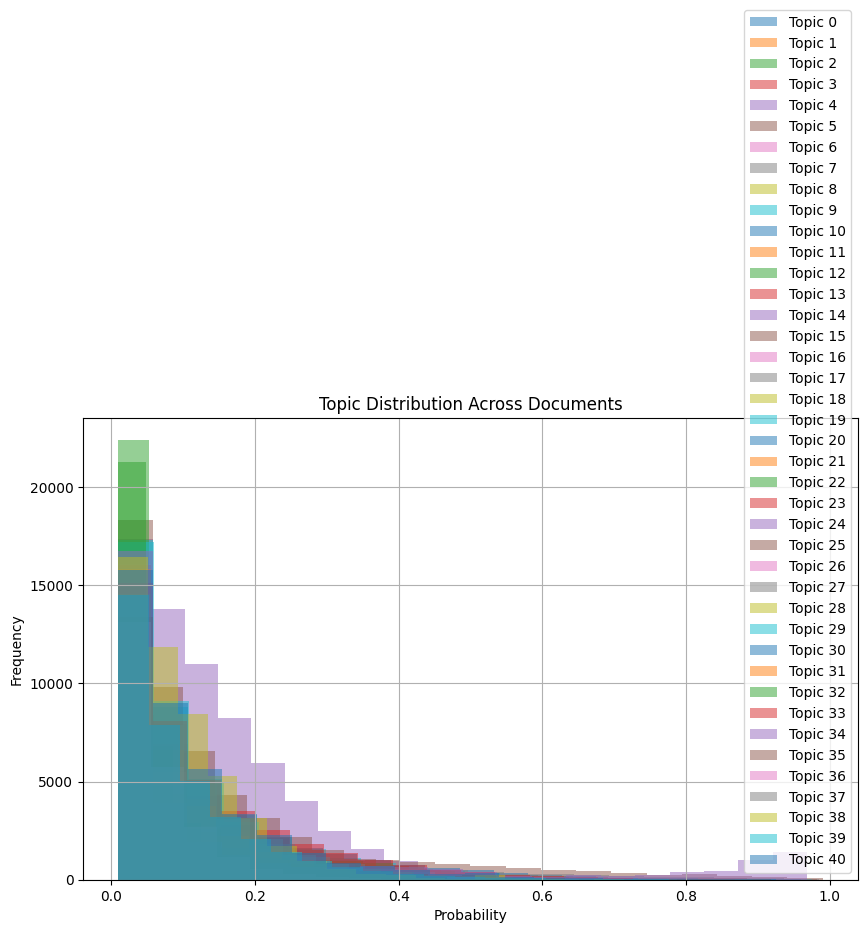

In [18]:
import matplotlib.pyplot as plt

# Get topic distribution for each document
topic_distribution = [lda_model.get_document_topics(doc) for doc in corpus]

# Initialize an empty list to store topic probabilities for each document
topic_probabilities = [[] for _ in range(num_topics)]

# Populate the topic probabilities list
for doc_topics in topic_distribution:
    for topic, prob in doc_topics:
        topic_probabilities[topic].append(prob)

# Plotting
plt.figure(figsize=(10, 6))
for i, topic_probs in enumerate(topic_probabilities):
    plt.hist(topic_probs, bins=20, alpha=0.5, label='Topic {}'.format(i))

plt.xlabel('Probability')
plt.ylabel('Frequency')
plt.title('Topic Distribution Across Documents')
plt.legend()
plt.grid(True)
plt.show()


In [21]:
from gensim.models import CoherenceModel

# Compute coherence score
coherence_model_lda = CoherenceModel(model=lda_model, texts=df['tokens'], dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()

print('Coherence Score:', coherence_lda)

Coherence Score: 0.5383793983504711


In [22]:
# Compute perplexity
perplexity_score = lda_model.log_perplexity(corpus)
print('Perplexity Score:', perplexity_score)


Perplexity Score: -11.396749752718037


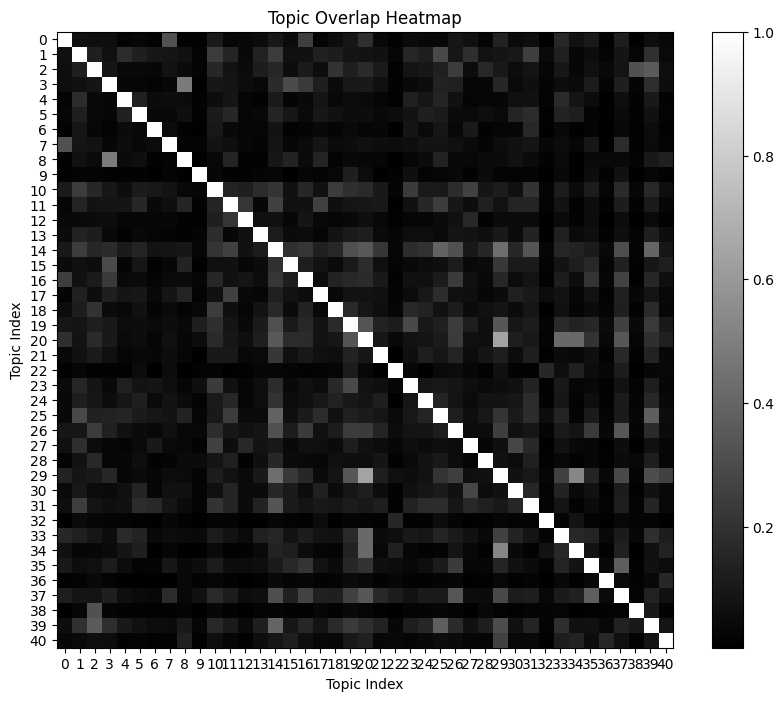

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import cosine_similarity
from gensim.models import LdaModel
from gensim.corpora import Dictionary

# Assuming lda_model is your trained LDA model
# Assuming dictionary is your Gensim dictionary

# Get the topic-term matrix from the LDA model
topic_matrix = lda_model.get_topics()

# Compute pairwise cosine similarity between topics
similarity_matrix = cosine_similarity(topic_matrix)

# Create a heatmap
plt.figure(figsize=(10, 8))
plt.imshow(similarity_matrix, cmap='gray', interpolation='nearest')

# Add colorbar
plt.colorbar()

# Set ticks and labels
num_topics = similarity_matrix.shape[0]
plt.xticks(np.arange(num_topics), np.arange(num_topics))
plt.yticks(np.arange(num_topics), np.arange(num_topics))
plt.xlabel('Topic Index')
plt.ylabel('Topic Index')
plt.title('Topic Overlap Heatmap')

plt.show()

#darker the color higher the similarity greater overlap

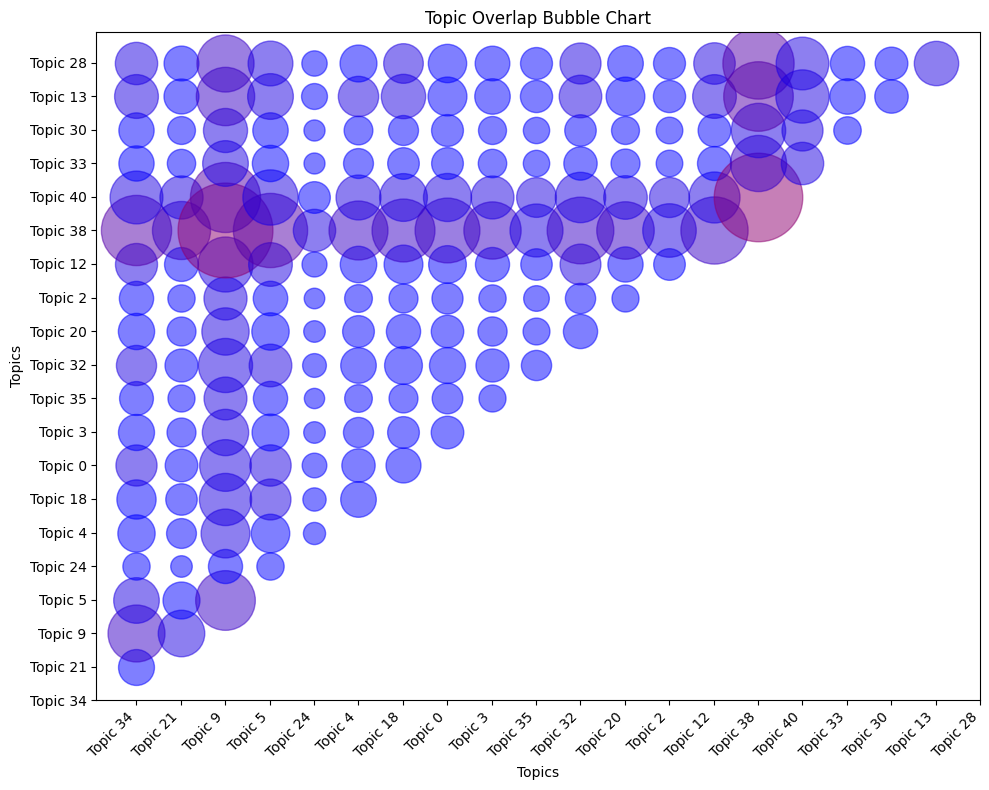

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

# Define the topic keywords and their distributions
topics = topics_dict

# Extract topic keywords and distributions
topic_keywords = list(topics.keys())
keyword_distributions = np.array([list(topic.values()) for topic in topics.values()])

# Calculate the overlap matrix
overlap_matrix = np.dot(keyword_distributions, keyword_distributions.T)

# Determine the maximum overlap value
max_overlap = np.max(overlap_matrix)

# Define a custom colormap
colors = [(0, 0, 1), (1, 0, 0)]  # Blue to red
cmap = LinearSegmentedColormap.from_list("Custom", colors, N=10)

# Plot the bubble chart with increased bubble size
plt.figure(figsize=(10, 8))
for i in range(overlap_matrix.shape[0]):
    for j in range(i + 1, overlap_matrix.shape[1]):
        bubble_size = overlap_matrix[i][j] / max_overlap * 8000  # Adjust bubble size relative to the maximum overlap
        color = 'red' if overlap_matrix[i][j] == max_overlap else cmap(overlap_matrix[i][j] / max_overlap)
        plt.scatter(i, j, s=bubble_size, alpha=0.5, label=f'Topic {i}-{j}', color=color)

# Add labels and legend
plt.xticks(range(len(topic_keywords)), topic_keywords, rotation=45, ha='right')
plt.yticks(range(len(topic_keywords)), topic_keywords)
plt.xlabel('Topics')
plt.ylabel('Topics')
plt.title('Topic Overlap Bubble Chart')
#plt.legend(prop={'size': 8})  # Set font size of legend labels

# Show plot
plt.tight_layout()
plt.show()

#Blue to red , hence the redder the color the greater the topic overlap 

In [29]:
# Initialize an empty list to store the most dominant topic for each document
dominant_topics = []

# Iterate through the topic distributions for each document
for doc_topics in topic_distribution:
    # Sort the topic probabilities in descending order
    sorted_topics = sorted(doc_topics, key=lambda x: x[1], reverse=True)
    # Get the most dominant topic (the one with the highest probability)
    dominant_topic = sorted_topics[0][0]
    dominant_topics.append(dominant_topic)

# Add the dominant topics to the DataFrame
df['dominant_topic'] = dominant_topics

# Print the most dominant topic for each document
for index, row in df.iterrows():
    print("Document {}: Dominant Topic {}".format(index, row['dominant_topic']))


Document 1: Dominant Topic 32
Document 2: Dominant Topic 28
Document 3: Dominant Topic 34
Document 4: Dominant Topic 28
Document 5: Dominant Topic 28
Document 6: Dominant Topic 28
Document 7: Dominant Topic 28
Document 8: Dominant Topic 28
Document 9: Dominant Topic 28
Document 10: Dominant Topic 28
Document 11: Dominant Topic 28
Document 12: Dominant Topic 28
Document 13: Dominant Topic 28
Document 14: Dominant Topic 28
Document 15: Dominant Topic 28
Document 16: Dominant Topic 28
Document 17: Dominant Topic 28
Document 18: Dominant Topic 28
Document 19: Dominant Topic 28
Document 20: Dominant Topic 28
Document 21: Dominant Topic 28
Document 22: Dominant Topic 28
Document 23: Dominant Topic 14
Document 24: Dominant Topic 14
Document 25: Dominant Topic 28
Document 26: Dominant Topic 28
Document 27: Dominant Topic 28
Document 28: Dominant Topic 28
Document 29: Dominant Topic 28
Document 30: Dominant Topic 28
Document 31: Dominant Topic 28
Document 32: Dominant Topic 28
Document 33: Domi

## Abstractive Summarisation

In [29]:
#!pip3 install torch torchvision torchaudio
#!pip install transformers
#!pip install sentencepiece

  Obtaining dependency information for torchaudio from https://files.pythonhosted.org/packages/8c/49/e37b6cacaef3fefdab3c508ef04f6cbdbfcf5c014a5ba28cb62ab33badd6/torchaudio-2.2.1-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/2.4 MB ? eta -:--:--
    --------------------------------------- 0.0/2.4 MB 660.6 kB/s eta 0:00:04
   -- ------------------------------------- 0.1/2.4 MB 1.4 MB/s eta 0:00:02
   ------- -------------------------------- 0.5/2.4 MB 3.7 MB/s eta 0:00:01
   -------------- ------------------------- 0.9/2.4 MB 4.9 MB/s eta 0:00:01
   -------------------- ------------------- 1.2/2.4 MB 5.6 MB/s eta 0:00:01
   ----------------------------- ---------- 1.7/2.4 MB 6.5 MB/s eta 0:00:01
   ---------------------------------------  2.4/2.4 MB 7.9 MB/s eta 0:00:01
   ---------------------------------------- 2.4/2.4 MB 7.5 MB/s eta 0:00:00


In [ ]:
from transformers import PegasusForConditionalGeneration, PegasusTokenizer
import torch

model_name = 'google/pegasus-xsum'
torch_device = 'cuda' if torch.cuda.is_available() else 'cpu'
tokenizer = PegasusTokenizer.from_pretrained(model_name)
model = PegasusForConditionalGeneration.from_pretrained(model_name).to(torch_device)

In [ ]:
for index, row in df.iterrows():
    src_text = row['Body']
    #print("Text in Row {}: {}".format(index, text))
    batch = tokenizer.prepare_seq2seq_batch(src_text, truncation=True, padding='longest',return_tensors='pt')
    translated = model.generate(**batch)
    tgt_text = tokenizer.batch_decode(translated, skip_special_tokens=True)
    print(tgt_text)